# Clustering of all data

Read in all necessary packages:

In [5]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from pandas.io.parsers import read_csv
import scvelo as scv
import scanpy as sc
import numpy as np
from functools import reduce
from anndata import AnnData, read_h5ad
import singlecellmultiomics.bamProcessing.bamToRNACounts
import loompy
import collections

In [6]:
scv.settings.verbosity = 3 # show errors(0), warnings(1), info(2), hints(3)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

scv.settings.presenter_view = True  # set max width size for presenter view
sc.set_figure_params(dpi=100, color_map = 'viridis')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.19.2 scipy==1.8.0 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.9 pynndescent==0.5.6


# Load the dataset

In [ ]:
#import loom in adata
adata = sc.read_h5ad('data/20230619_allGastruloids.h5ad')
adata

In [4]:
len(adata.obs['batch'].unique())

120

We can make a scatter plot in the PCA coordinates, but we will not use that later on.

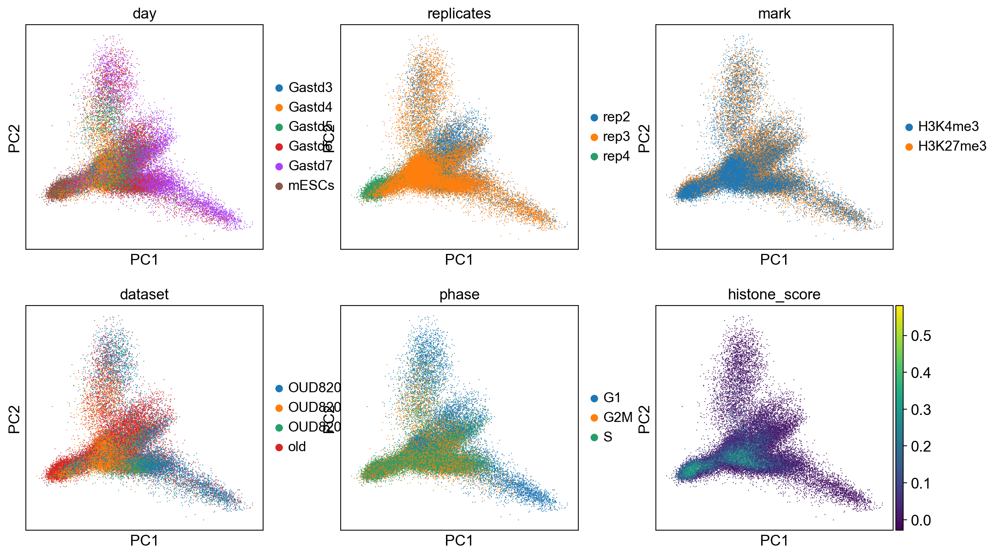

In [7]:
sc.pl.pca(adata, color = ['day', 'replicates','mark','dataset','phase', 'histone_score'], color_map = 'viridis', ncols=3)

Load ChIC QC selectors:

In [8]:
cell_selection_k27 = pd.read_csv('data/K27_new_QC2.csv', sep = ',', index_col=0)
cell_selection_k27.head(2)

,QC,enrichment,coverage
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341,good,78.808261,38.540
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310,good,70.389349,34.978


In [9]:
cell_selection_k4 = pd.read_csv('data/K4_new_QC2.csv', sep = ',', index_col=0)
cell_selection_k4.head(2)

,QC,enrichment,coverage
PZ-MB-TChIC-Gastd5-rep2-H3K4me3-1_362,good,79.449153,24.354
PZ-MB-TChIC-Gastd5-rep2-H3K4me3-1_288,good,76.858276,23.834


In [10]:
cell_selection = pd.concat([cell_selection_k27,cell_selection_k4])

In [11]:
print(len(cell_selection_k27), len(cell_selection_k4), len(cell_selection), len(cell_selection_k4)+len(cell_selection_k27))

20640 20141 40781 40781


In [12]:
cell_selection=cell_selection.fillna('missing')

In [13]:
adata.obs[['enrichment','coverage','QC']] = cell_selection[['enrichment','coverage','QC']]

In [14]:
adata.obs.head(2)

,batch2,batch,day,replicates,mark,day_rep,dataset,cellnames,bc,cellname,...,n_counts_stressgenes,n_genes,S_score,G2M_score,phase,histone_score,mark_binary,enrichment,coverage,QC
index,,,,,,,,,,,,,,,,,,,,,
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341,PZ-MB-TChIC-Gastd5-rep2-H3K27me3,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1,Gastd5,rep2,H3K27me3,Gastd5_rep2,old,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1:AACCTGCT,341,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341,...,34.0,3597,-0.025686,-0.040124,G1,0.002229,1,78.808261,38.540,good
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310,PZ-MB-TChIC-Gastd5-rep2-H3K27me3,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1,Gastd5,rep2,H3K27me3,Gastd5_rep2,old,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1:AATGGTGG,310,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310,...,107.0,5887,0.113965,0.081538,S,0.018229,1,70.389349,34.978,good


In [15]:
adata.obs[['mark','QC']].value_counts()

mark      QC  
H3K27me3  good    19838
H3K4me3   good    18279
          bad      1862
H3K27me3  bad       802
dtype: int64

In [16]:
adata.obs['enrichment'] = adata.obs['enrichment'].astype(float)

In [17]:
adata[adata.obs['QC'] == 'good'].obs['enrichment'].mean(), adata[adata.obs['QC'] == 'good'].obs['enrichment'].min(), adata[adata.obs['QC'] == 'good'].obs['enrichment'].max()

(81.3875422193531, 65.00035006651265, 100.00000000000004)

In [18]:
adata[adata.obs['QC'] == 'bad'].obs['enrichment'].mean(), adata[adata.obs['QC'] == 'bad'].obs['enrichment'].min(), adata[adata.obs['QC'] == 'bad'].obs['enrichment'].max()

(56.00580262698601, 28.03908794788273, 64.99923277581709)

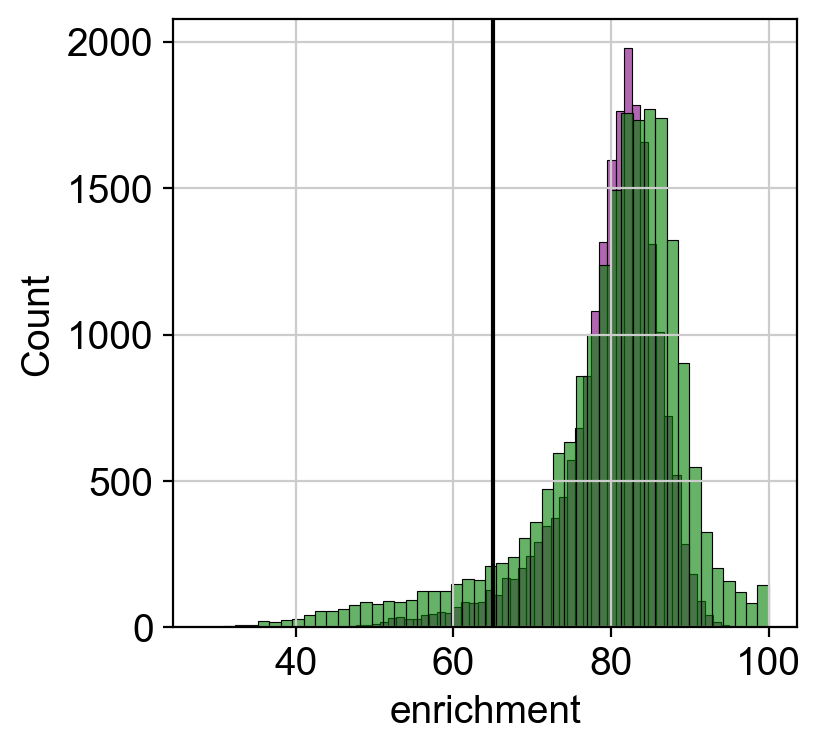

In [19]:
sns.histplot(data=adata[adata.obs['mark'] == 'H3K27me3'].obs['enrichment'], color = 'purple', alpha = 0.6, bins = 50)
sns.histplot(data=adata[adata.obs['mark'] == 'H3K4me3'].obs['enrichment'], color = 'green', alpha = 0.6, bins = 50)
plt.axvline(x = 65, color = 'black')


In [20]:
adata.obs['coverage'] = adata.obs['coverage'].astype(float)

<AxesSubplot:xlabel='coverage', ylabel='Count'>

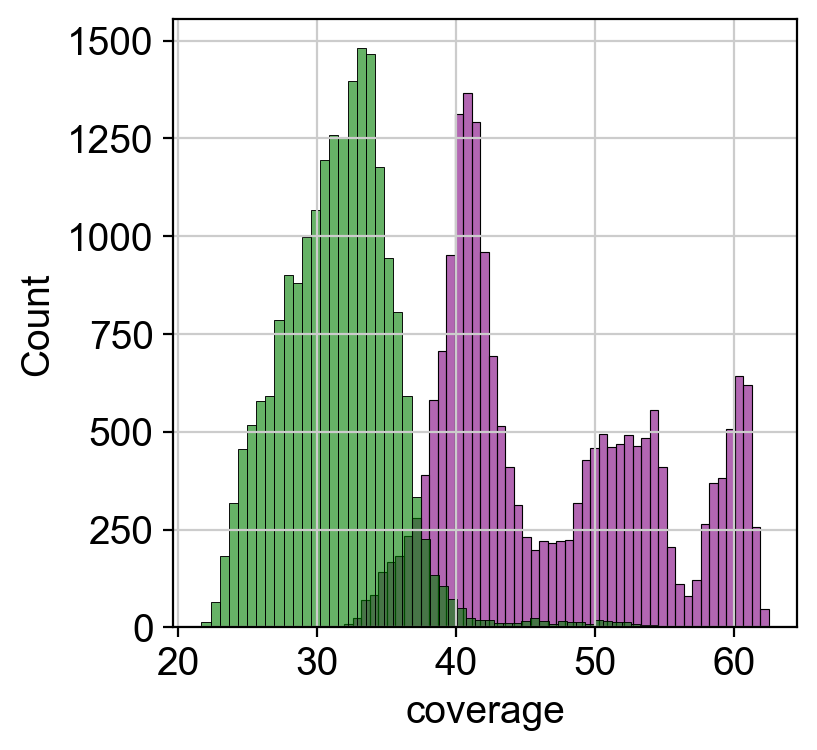

In [21]:
sns.histplot(data=adata[adata.obs['mark'] == 'H3K27me3'].obs['coverage'], color = 'purple', alpha = 0.6, bins = 50)
sns.histplot(data=adata[adata.obs['mark'] == 'H3K4me3'].obs['coverage'], color = 'green', alpha = 0.6, bins = 50)



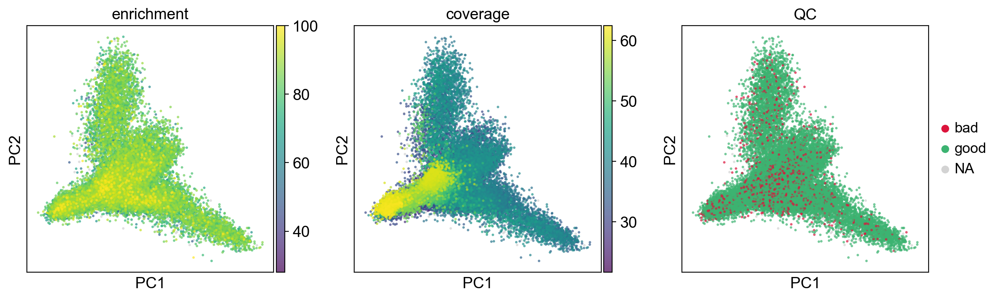

In [22]:
sc.pl.pca(adata, color = ['enrichment','coverage','QC'], ncols=3, palette = ['crimson','mediumseagreen','slategrey'], size = 20, alpha = 0.7)

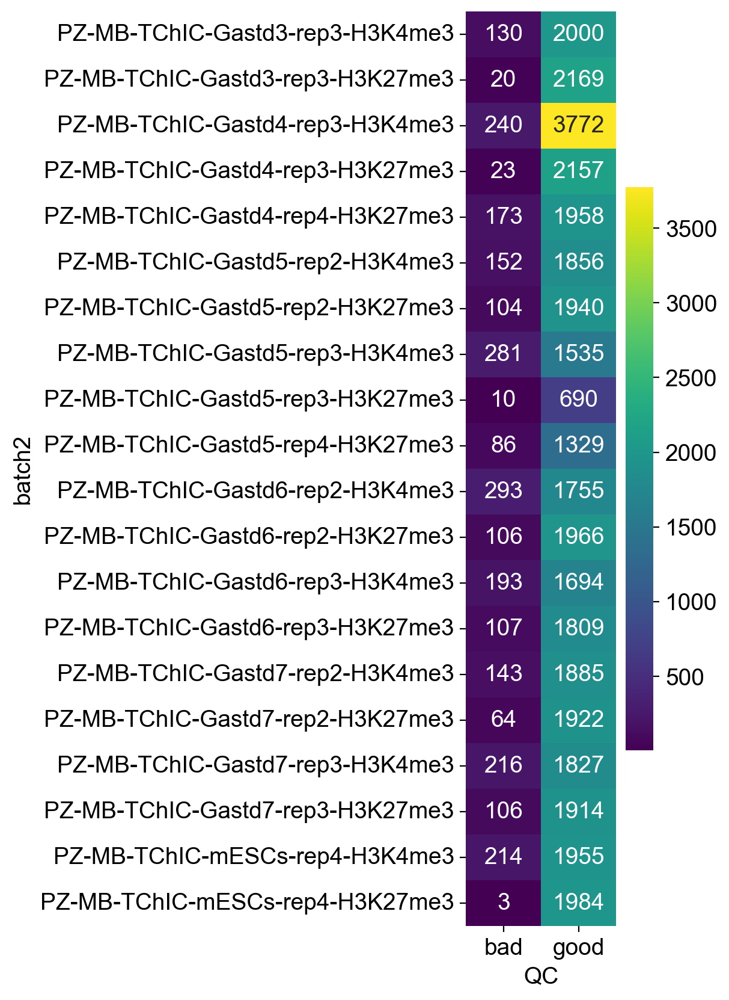

In [23]:
plt.figure(figsize=(2,10))
sns.heatmap(pd.crosstab(adata.obs['batch2'], adata.obs['QC'], normalize = False), fmt = 'g',
                                     cmap = "viridis",annot = True)
plt.show()

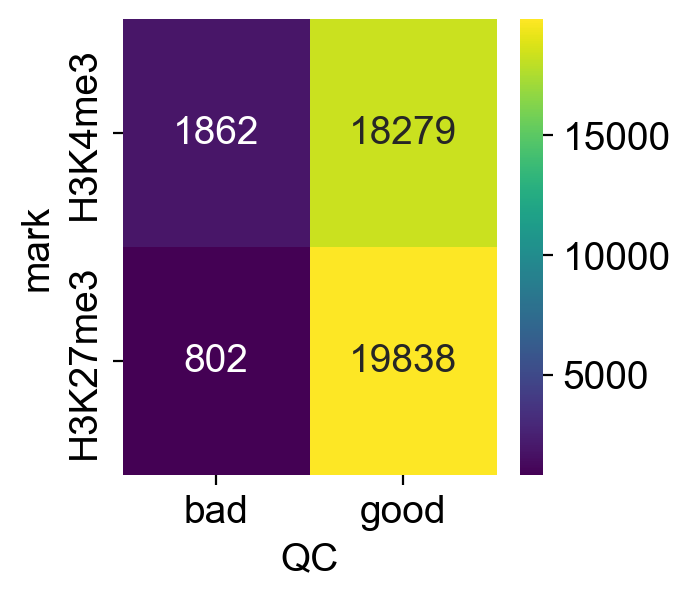

In [24]:
plt.figure(figsize=(3,3))
sns.heatmap(pd.crosstab(adata.obs['mark'], adata.obs['QC'], normalize = False), fmt = 'g',
                                     cmap = "viridis",annot = True)
plt.show()

Subset the adata file based on good/bad chic annotation

In [25]:
adata = adata[adata.obs['QC'] == 'good']
adata

View of AnnData object with n_obs × n_vars = 38117 × 27384
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname', 'percent_mito', 'n_counts', 'n_counts_proteincoding', 'n_counts_stressgenes', 'n_genes', 'S_score', 'G2M_score', 'phase', 'histone_score', 'mark_binary', 'enrichment', 'coverage', 'QC'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype', 'gene_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'dataset_colors', 'day_colors', 'hvg', 'log1p', 'mark_colors', 'pca', 'phase_colors', 'replicates_colors', 'QC_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

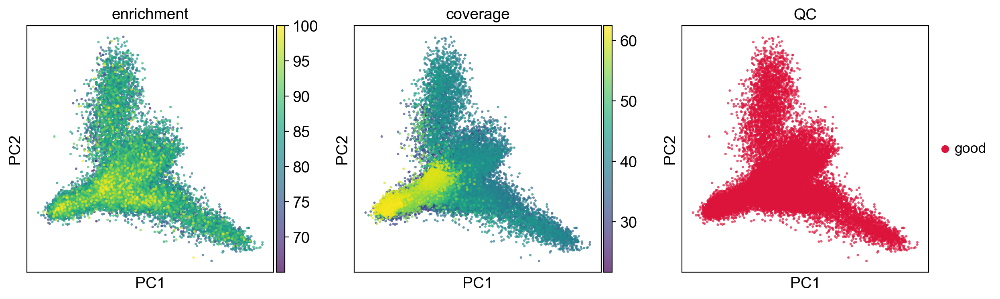

In [26]:
sc.pl.pca(adata, color = ['enrichment','coverage','QC'], ncols=3, palette = ['crimson','mediumseagreen','slategrey'], size = 20, alpha = 0.7)

In [27]:
adata.obs[['mark','QC']].value_counts()

mark      QC  
H3K27me3  good    19838
H3K4me3   good    18279
dtype: int64

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [28]:
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=50, metric  = 'manhattan')



computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:17)


## Embedding the neighborhood graph

We advertise embedding the graph in 2 dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is  potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preservers trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [108]:
sc.tl.umap(adata, init_pos = 'spectral', spread = 0.6,min_dist=0.4)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


We can define which characteristics of the data we would like to display. E.g. libraries, histone marks, time points etc. Then we can easily plot those to check for possible batch effects.

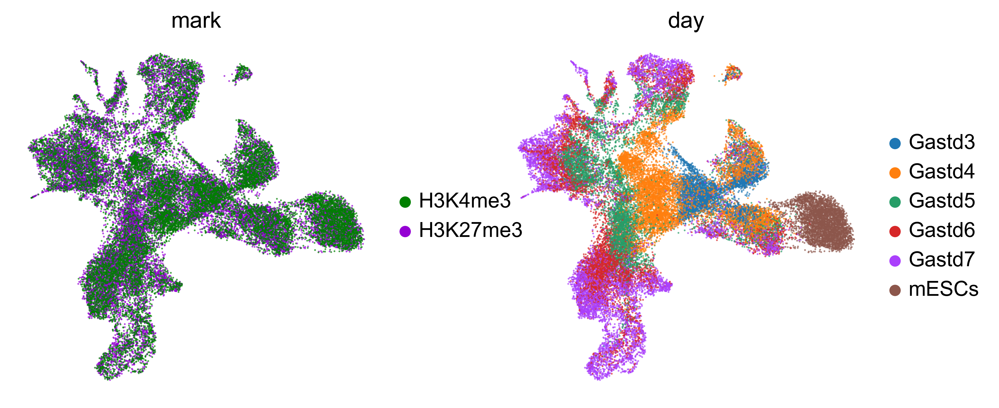

In [109]:
sc.pl.umap(adata, color=['mark','day'],frameon=False, size=5, alpha=0.7)

In [111]:
#they are added under 'obs'
adata

AnnData object with n_obs × n_vars = 38117 × 27384
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname', 'percent_mito', 'n_counts', 'n_counts_proteincoding', 'n_counts_stressgenes', 'n_genes', 'S_score', 'G2M_score', 'phase', 'histone_score', 'mark_binary', 'enrichment', 'coverage', 'QC', 'umap_density_mark', 'predicted_id_E75', 'predicted_id_E85', 'prediction_confidence_E75', 'prediction_confidence_E85', 'predicted_final', 'leiden'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype', 'gene_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'dataset_colors', 'day_colors', 'hvg', 'log1p', 'mark_colors', 'pca', 'phase_colors', 'replicates_colors', 'QC_colors', 'neighbors', 'umap', 'umap_density_mark_params', 'predicted_id_E75_colors', 'predicted_id_E85_colors', 'predicted_final_colors', 'leiden', 'leiden_colors'
    obsm: 'X_pca'

In [112]:
sc.set_figure_params(dpi=150, color_map = 'viridis')

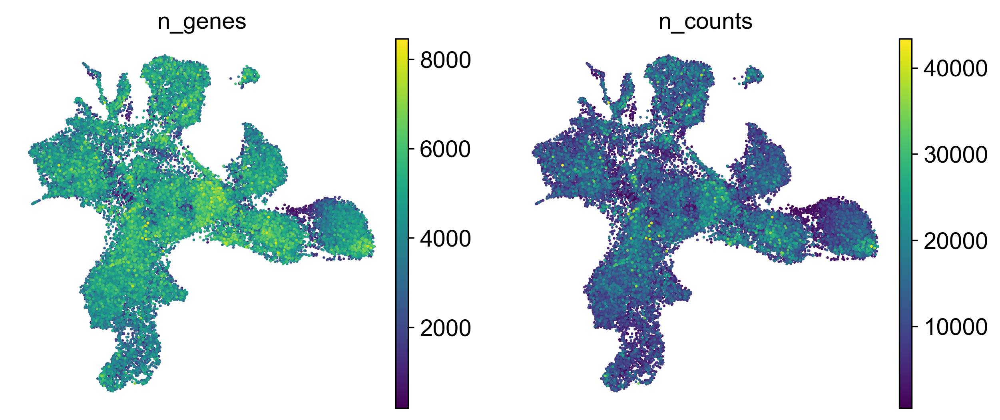

In [129]:
sc.pl.umap(adata, color=['n_genes','n_counts'], size = 10, color_map = 'viridis',frameon=False)

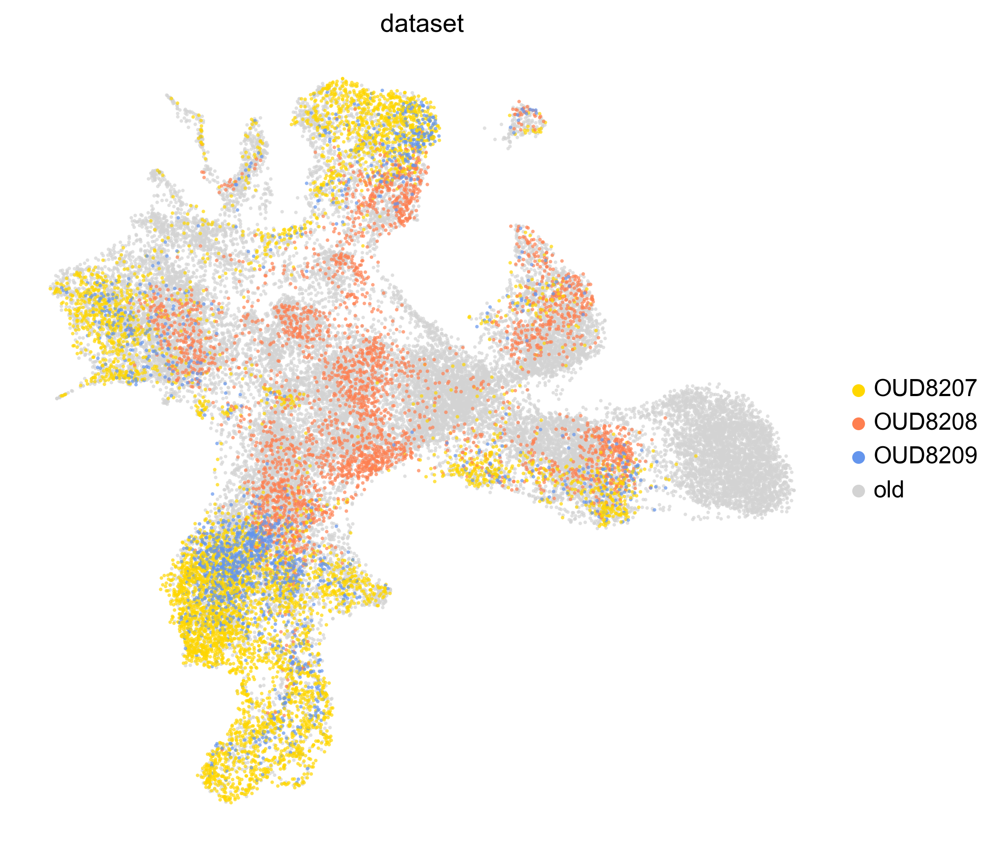

In [117]:
fig, ax = plt.subplots(figsize=(8,8))
sc.pl.umap(adata, color='dataset',ax=ax,size=15, frameon=False, 
           palette= ['gold','coral','cornflowerblue','lightgrey','navy'], 
           alpha=0.7)

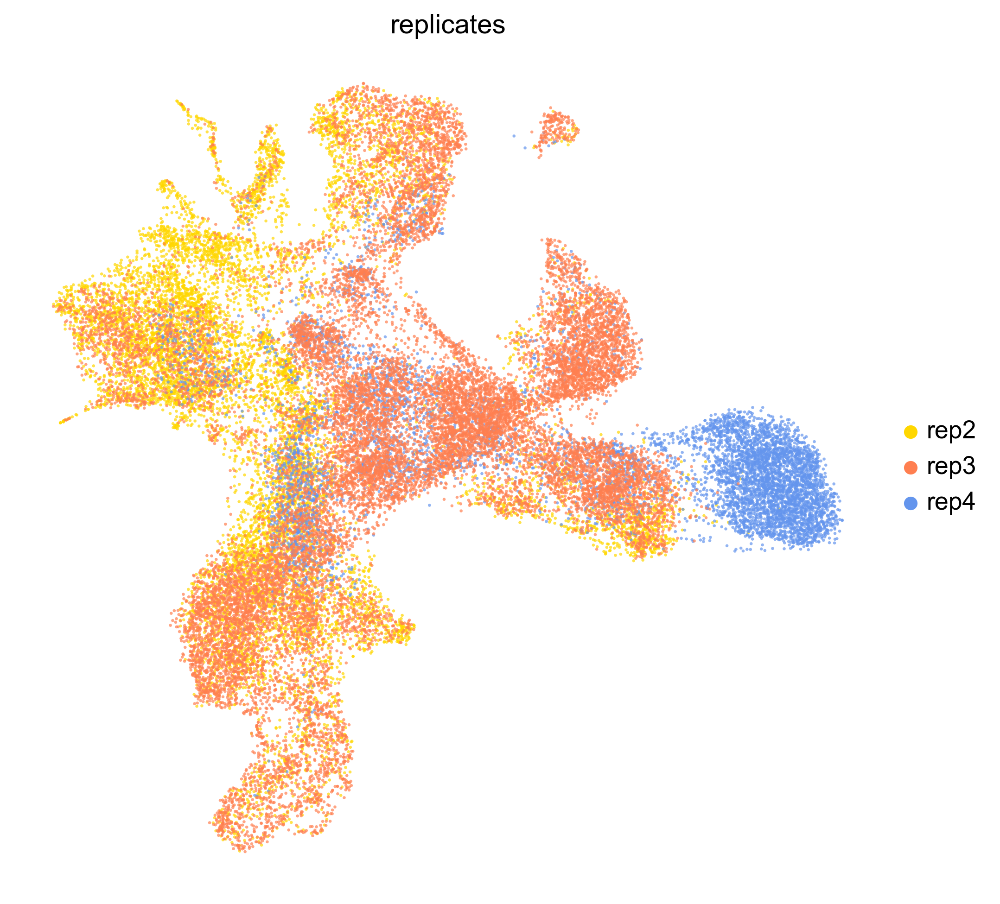

In [118]:
fig, ax = plt.subplots(figsize=(8,8))
sc.pl.umap(adata, color='replicates',ax=ax,size=10,frameon=False,palette= ['gold','coral','cornflowerblue','lightseagreen','navy'], 
           alpha=0.7)

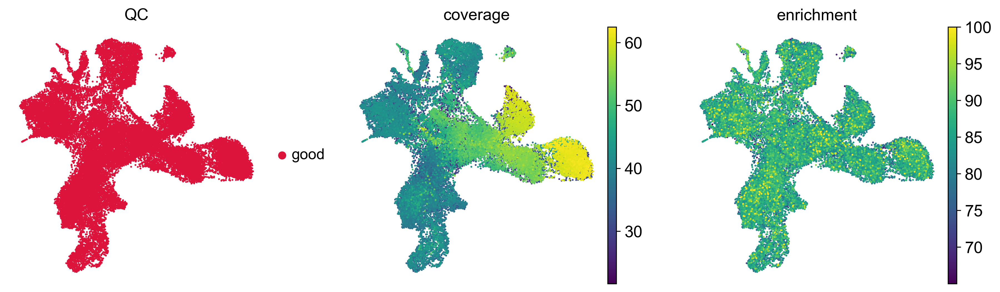

In [119]:
sc.pl.umap(adata, color = ['QC','coverage','enrichment'], ncols=3, #palette = ['crimson','darkgrey','slategrey'], 
           size = 10, frameon=False)

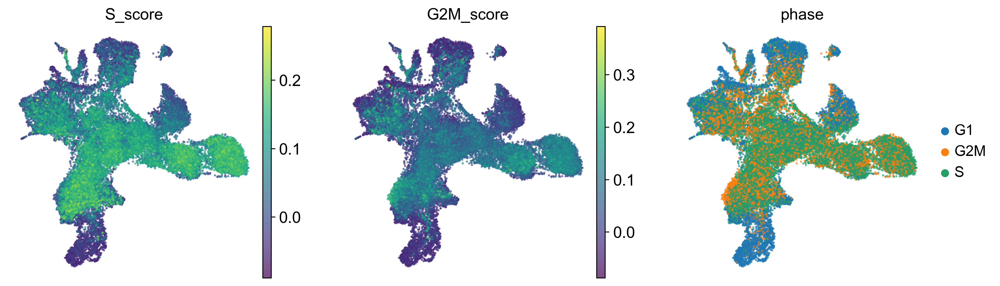

In [120]:
sc.pl.umap(adata, color=['S_score','G2M_score','phase'],frameon=False,
           size=15, alpha=0.7)

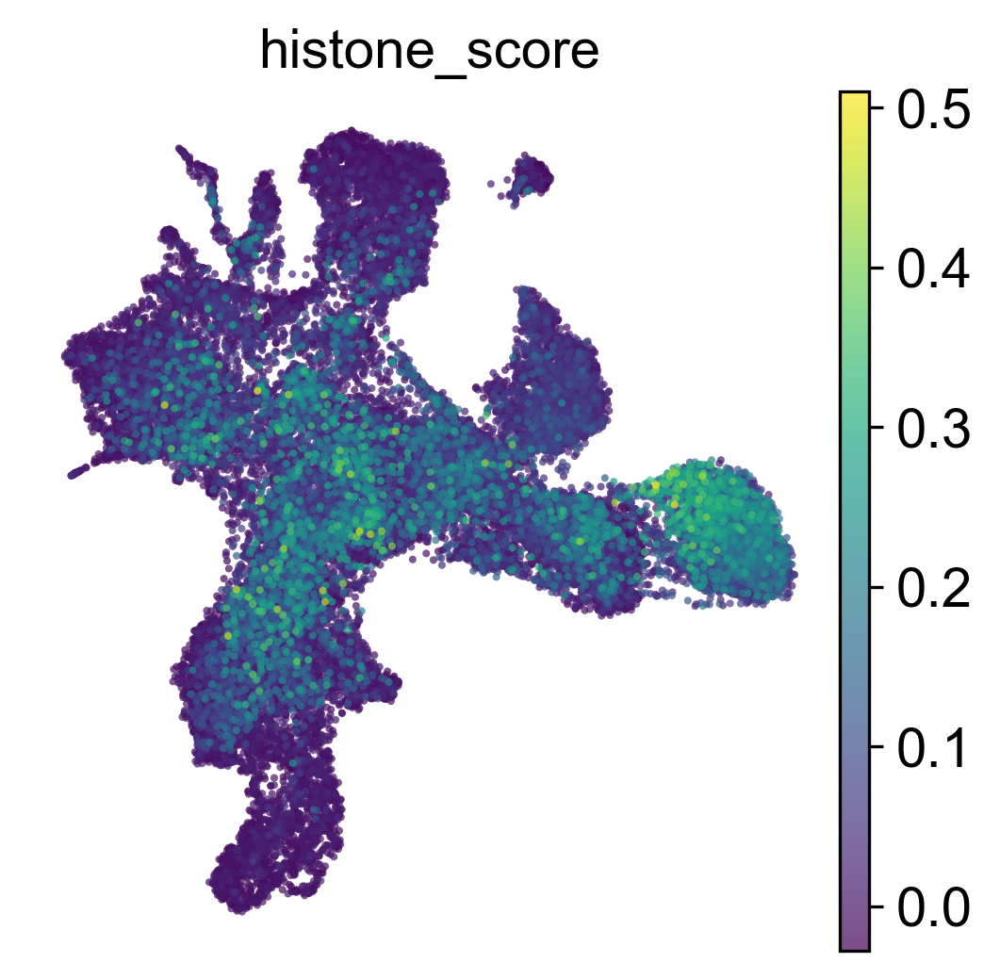

In [121]:
sc.pl.umap(adata, color=['histone_score'],frameon=False,
           size=15, alpha=0.7)

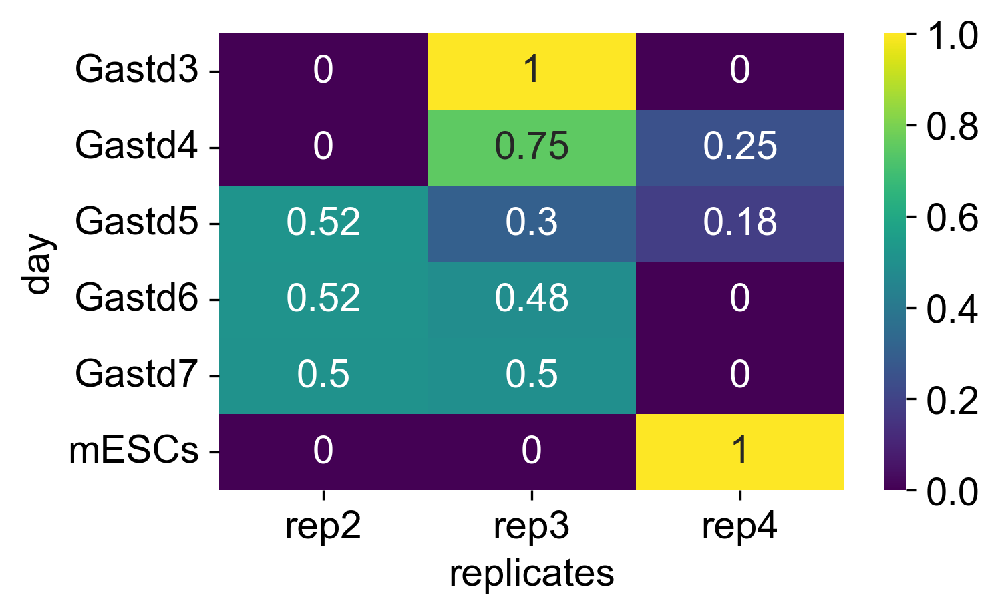

In [122]:
plt.figure(figsize=(5,3))
sns.heatmap(pd.crosstab(adata.obs['day'], adata.obs['replicates'], normalize = 'index'), 
                                     cmap = "viridis",annot = True)
plt.show()

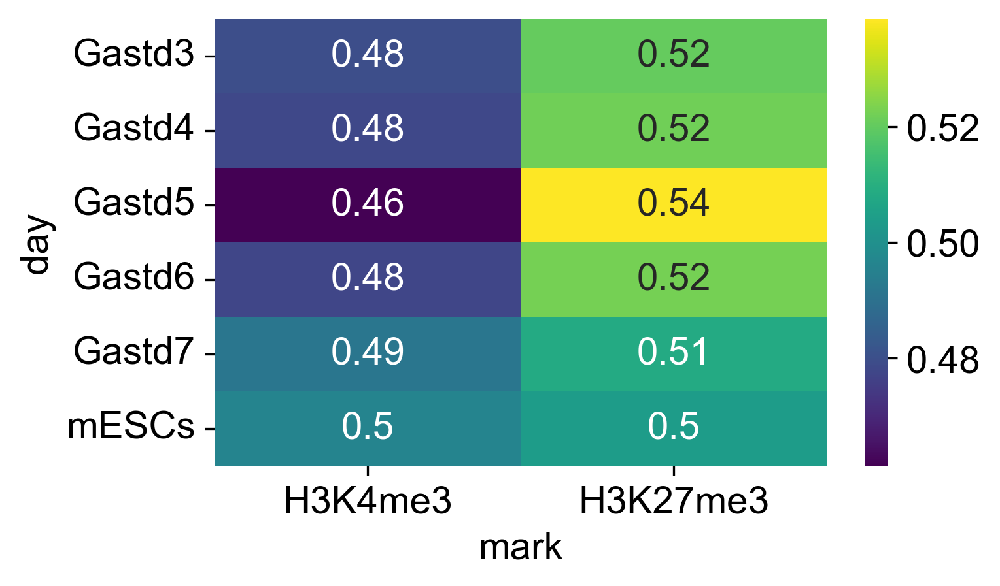

In [123]:
plt.figure(figsize=(5,3))
sns.heatmap(pd.crosstab(adata.obs['day'], adata.obs['mark'], normalize = 'index'), 
                                     cmap = "viridis",annot = True)
plt.show()

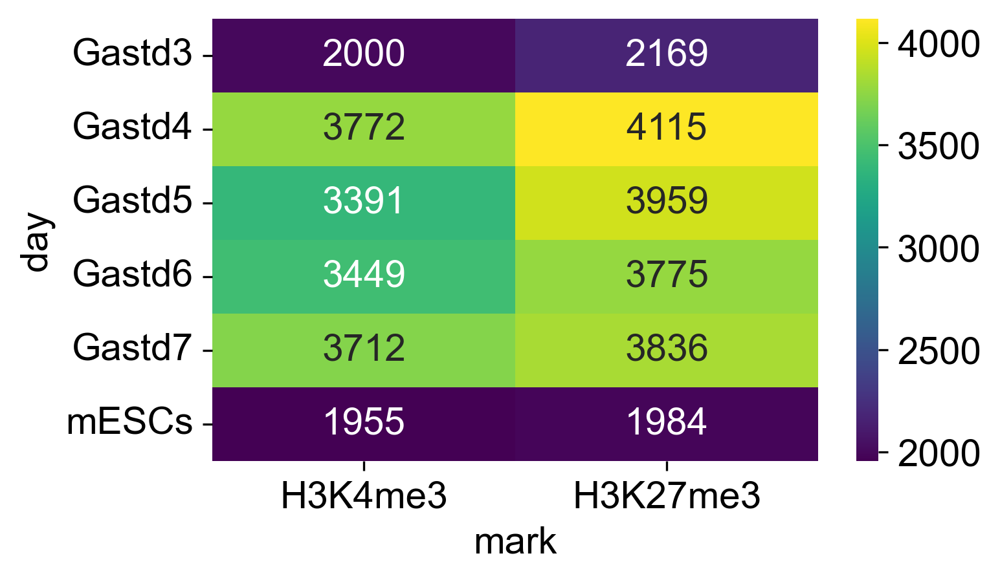

In [124]:
plt.figure(figsize=(5,3))
sns.heatmap(pd.crosstab(adata.obs['day'], adata.obs['mark']), 
                                     cmap = "viridis",annot = True,fmt='g')
plt.show()

In [125]:
adata.obs[['mark','day']].value_counts().sort_index()

mark      day   
H3K4me3   Gastd3    2000
          Gastd4    3772
          Gastd5    3391
          Gastd6    3449
          Gastd7    3712
          mESCs     1955
H3K27me3  Gastd3    2169
          Gastd4    4115
          Gastd5    3959
          Gastd6    3775
          Gastd7    3836
          mESCs     1984
dtype: int64

# Add cell labels and clustering the neighbourhood graph

In [141]:
sc.tl.leiden(adata, resolution = 0.04)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


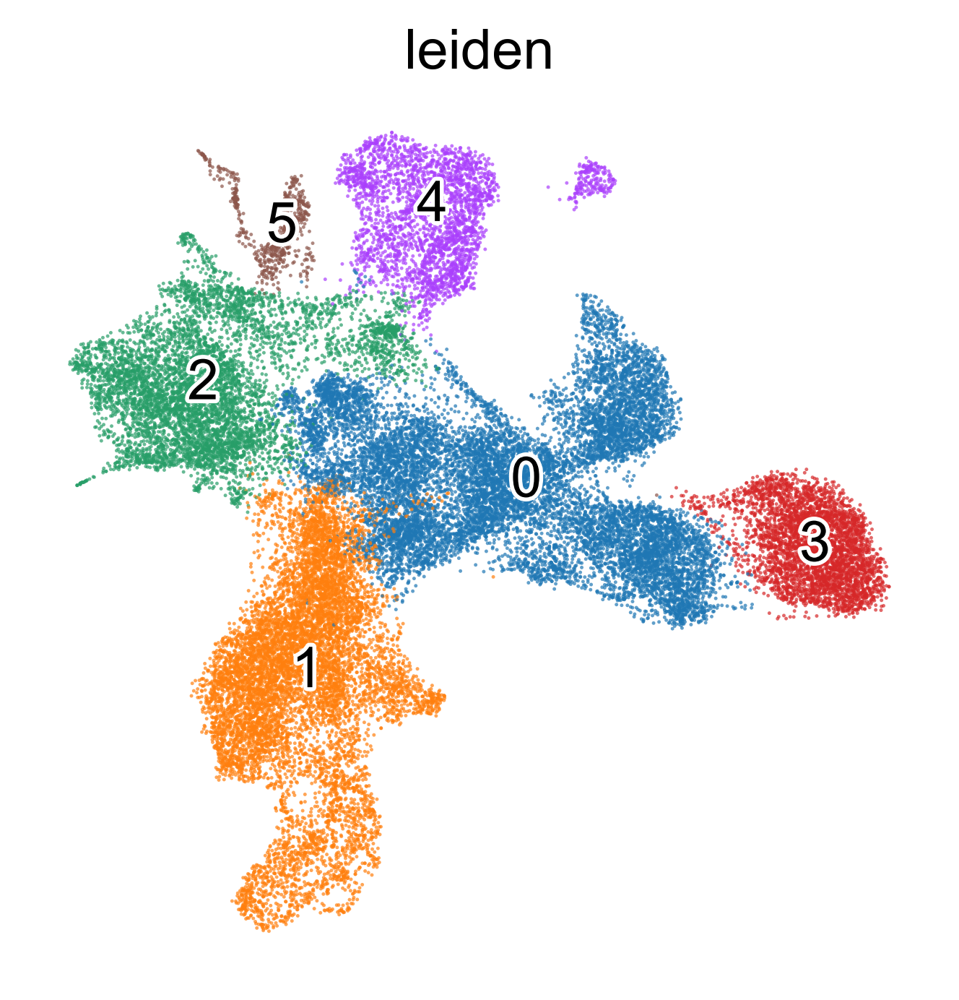

In [142]:
fig, ax = plt.subplots(figsize=(4,4))
sc.pl.umap(adata, color='leiden',ax=ax,# palette=['#009933', '#FF00CC','#666666','#0066CC'],
           #size=100,
           legend_fontweight="normal",legend_fontoutline=2,
           frameon=False, alpha = 0.7, legend_loc = 'on data')

In [143]:
adata.obs['celltype'] = adata.obs['leiden']
adata.rename_categories('celltype',['Pluripotent','Ectoderm','Mesoderm','mESCs','Endoderm','Haemogenic'])


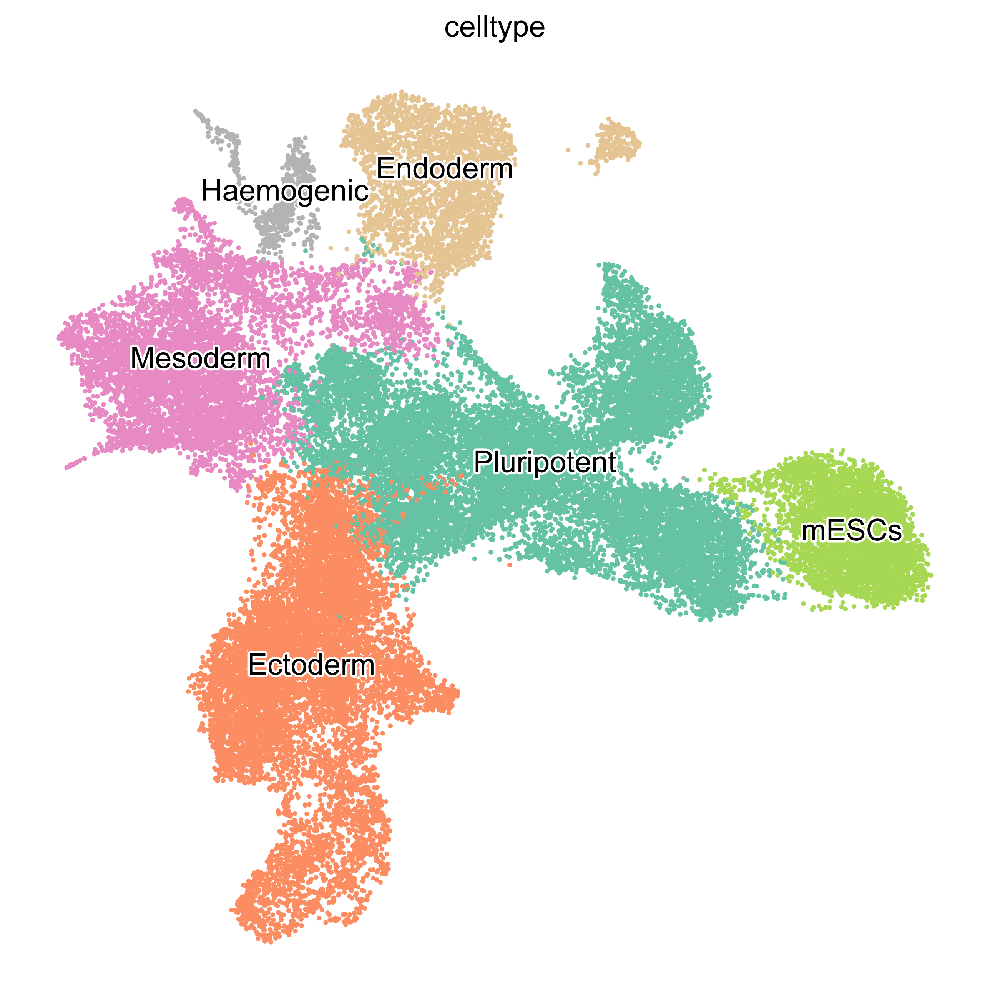

In [144]:
fig, ax = plt.subplots(figsize=(8,8))
sc.pl.umap(adata, color='celltype',ax=ax, palette='Set2', #sns.color_palette("hls", len(adata.obs['leiden'].unique())),
           frameon=False, legend_loc = "on data", legend_fontweight="normal",
           legend_fontoutline=2, size=20)

# Save the result.

In [152]:
results_file = 'data/20230619_allGastruloids_UMAP_celltypes.h5ad'

In [153]:
adata.write(results_file)

In [154]:
adata.obs.to_csv('data/20230619_adata_obs_all.csv')